In [1]:
import seaborn
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
plt.rcParams['figure.figsize'] = (13, 5)

In [2]:
x, sr = librosa.load('3.mp3')
ipd.Audio(x, rate=sr)

/Users/abrahamtomety/opt/anaconda3/envs/pytorch/lib/python3.9/site-packages/librosa/util/decorators.py:88: UserWarning: PySoundFile failed. Trying audioread instead.
  return f(*args, **kwargs)


In [3]:
hop_length = 512 # samples per frame
onset_env = librosa.onset.onset_strength(x, sr=sr, hop_length=hop_length, n_fft=2048)

/var/folders/z1/r1cdnpq10tq26gff1g61174c0000gn/T/ipykernel_4331/859445316.py:2: FutureWarning: Pass y=[0. 0. 0. ... 0. 0. 0.] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  onset_env = librosa.onset.onset_strength(x, sr=sr, hop_length=hop_length, n_fft=2048)


In [8]:
frames = range(len(onset_env))
t = librosa.frames_to_time(frames, sr=sr, hop_length=hop_length)

Text(0.5, 1.0, 'Novelty Function')

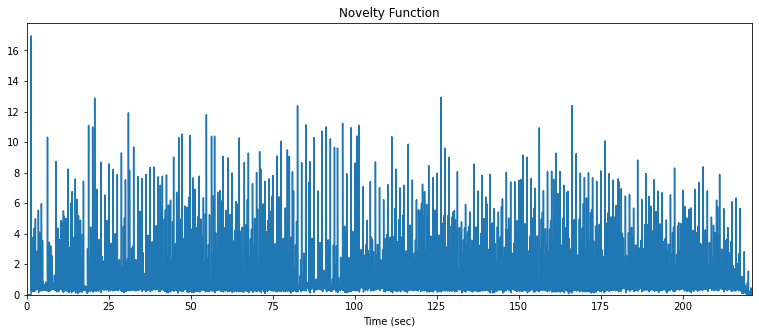

In [9]:
plt.plot(t, onset_env)
plt.xlim(0, t.max())
plt.ylim(0)
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

In [10]:
S = librosa.stft(onset_env, hop_length=1, n_fft=512)
fourier_tempogram = numpy.absolute(S)

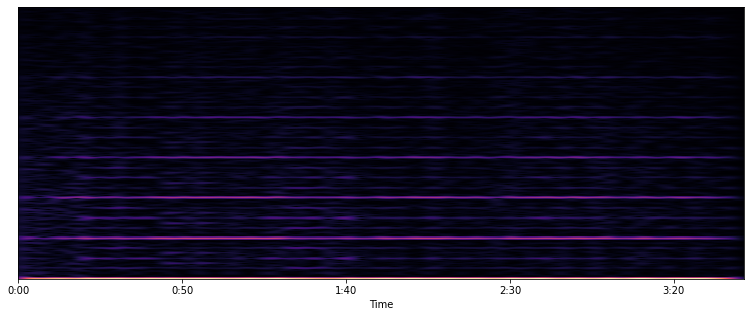

In [11]:
librosa.display.specshow(fourier_tempogram, sr=sr, hop_length=hop_length, x_axis='time')

Text(0.5, 1.0, 'Novelty Function')

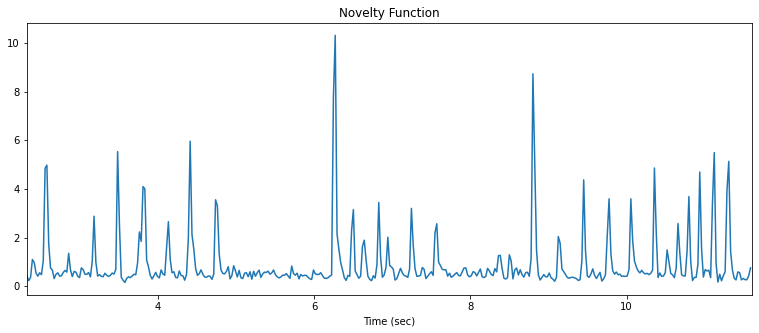

In [14]:
n0 = 100
n1 = 500
plt.plot(t[n0:n1], onset_env[n0:n1])
plt.xlim(t[n0], t[n1])
plt.xlabel('Time (sec)')
plt.title('Novelty Function')

In [15]:
tmp = numpy.log1p(onset_env[n0:n1])
r = librosa.autocorrelate(tmp)

(0.0, 187.0648737617919)

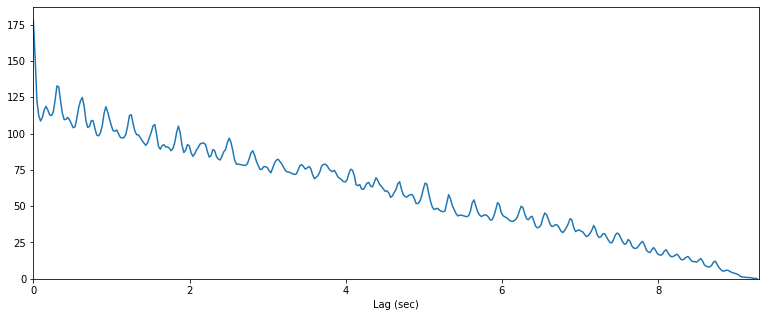

In [16]:
plt.plot(t[:n1-n0], r)
plt.xlim(t[0], t[n1-n0])
plt.xlabel('Lag (sec)')
plt.ylim(0)

/var/folders/z1/r1cdnpq10tq26gff1g61174c0000gn/T/ipykernel_4331/1652656273.py:1: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(60/t[:n1-n0], r)


(0.0, 159.58840985209068)

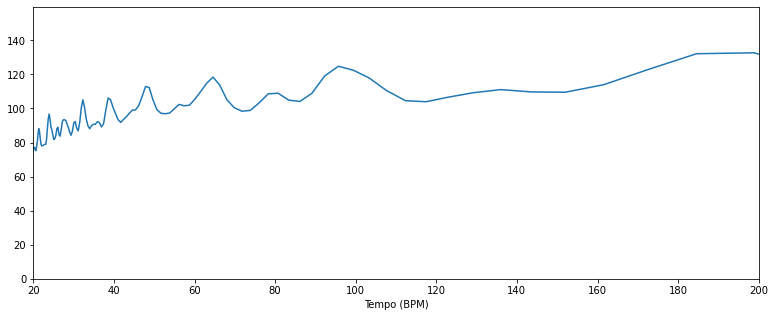

In [17]:
plt.plot(60/t[:n1-n0], r)
plt.xlim(20, 200)
plt.xlabel('Tempo (BPM)')
plt.ylim(0)

In [18]:
tempogram = librosa.feature.tempogram(onset_envelope=onset_env, sr=sr, hop_length=hop_length, win_length=400)

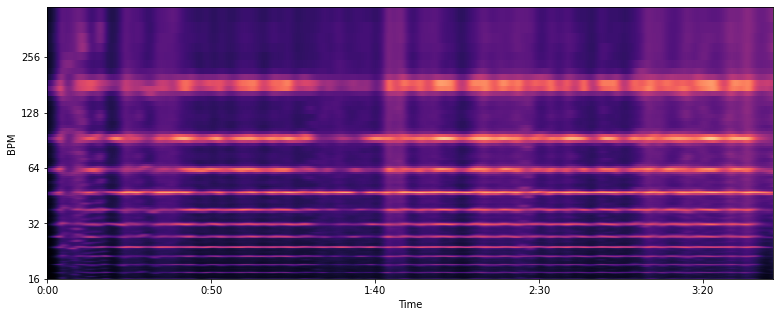

In [19]:
librosa.display.specshow(tempogram, sr=sr, hop_length=hop_length, x_axis='time', y_axis='tempo')

In [20]:
tempo = librosa.beat.tempo(x, sr=sr)
print(tempo)

/var/folders/z1/r1cdnpq10tq26gff1g61174c0000gn/T/ipykernel_4331/1757904990.py:1: FutureWarning: Pass y=[0. 0. 0. ... 0. 0. 0.] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  tempo = librosa.beat.tempo(x, sr=sr)


[95.703125]


In [21]:
T = len(x)/float(sr)
seconds_per_beat = 60.0/tempo[0]
beat_times = numpy.arange(0, T, seconds_per_beat)

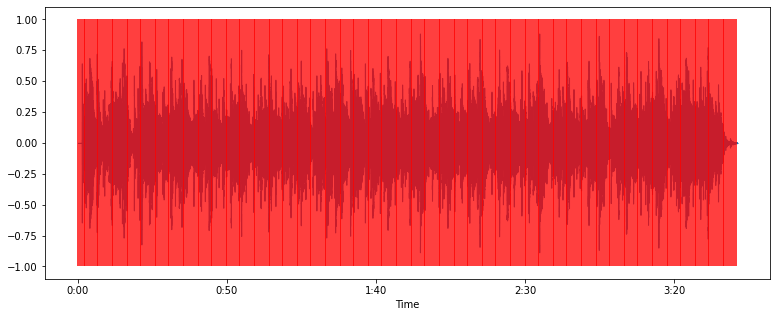

In [24]:
librosa.display.waveshow(x)
plt.vlines(beat_times, -1, 1, color='r')

In [25]:
clicks = librosa.clicks(beat_times, sr, length=len(x))
ipd.Audio(x + clicks, rate=sr)

/var/folders/z1/r1cdnpq10tq26gff1g61174c0000gn/T/ipykernel_4331/4129833394.py:1: FutureWarning: Pass times=[  0.           0.62693878   1.25387755   1.88081633   2.5077551
   3.13469388   3.76163265   4.38857143   5.0155102    5.64244898
   6.26938776   6.89632653   7.52326531   8.15020408   8.77714286
   9.40408163  10.03102041  10.65795918  11.28489796  11.91183673
  12.53877551  13.16571429  13.79265306  14.41959184  15.04653061
  15.67346939  16.30040816  16.92734694  17.55428571  18.18122449
  18.80816327  19.43510204  20.06204082  20.68897959  21.31591837
  21.94285714  22.56979592  23.19673469  23.82367347  24.45061224
  25.07755102  25.7044898   26.33142857  26.95836735  27.58530612
  28.2122449   28.83918367  29.46612245  30.09306122  30.72
  31.34693878  31.97387755  32.60081633  33.2277551   33.85469388
  34.48163265  35.10857143  35.7355102   36.36244898  36.98938776
  37.61632653  38.24326531  38.87020408  39.49714286  40.12408163
  40.75102041  41.37795918  42.00489796  4